<a href="https://colab.research.google.com/github/anuj0456/deep_learning_for_coders/blob/master/learn/Augly_L1_Image.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Install Packages

In [ ]:
!pip install  augly==0.1.6 

In [ ]:
!sudo apt-get install python3-magic 

# Import Packages

In [2]:
import os
import numpy as np
from PIL import Image
from PIL import ImageFilter
import augly.utils as utils
import augly.image as imaugs
from IPython.display import display

# Load Image

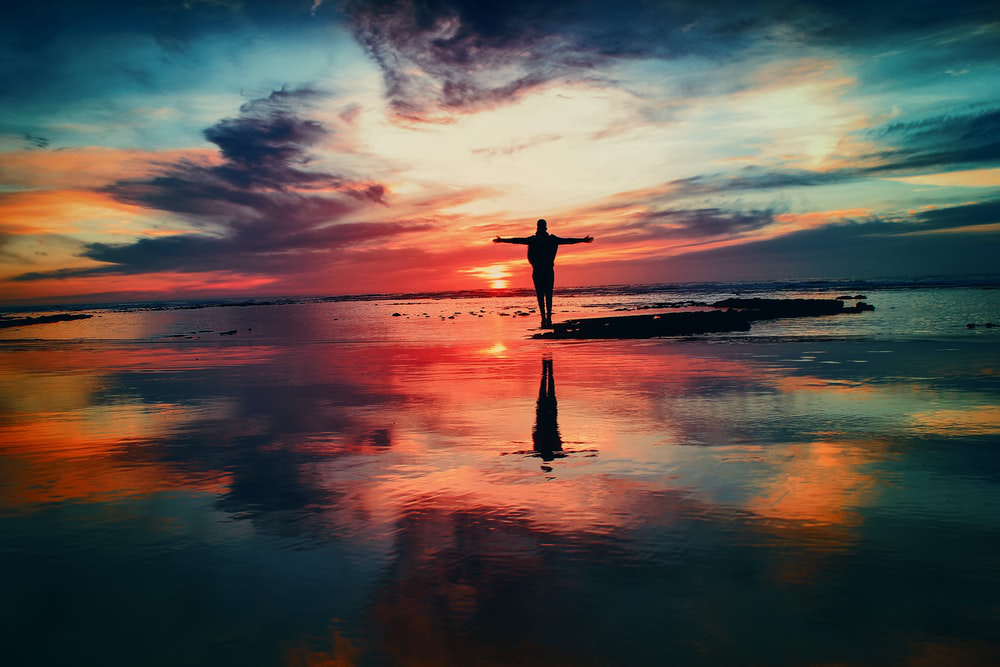

(1000, 667)


In [103]:
input_img_path = "/content/test.jpeg"
input_img = Image.open(input_img_path)
display(input_img)
print(input_img.size)

# Functions

### 1. apply_lambda

Short Desc - Applies a user-defined lambda on an image

Long Desc - This function applies a user defined function on the given input Image.
eg. The input Image is of size - (1000,67). After applying this function the size of the image will reduce to (100,100). This function gives the flexibility to user to apply any custom function/s on a given input image. 

Input - image(PIL format), output_path, aug_function, **kwargs(function attributes if any), metadata 

Output - image(augmented PIL Image)

In [ ]:
def resize_image(img=None, size=(100, 100)):
  img_resized = img.resize(size) 
  return img_resized

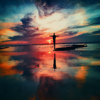

(100, 100)


In [ ]:
# basic
aug_lambda = imaugs.apply_lambda(input_img, aug_function=resize_image)
display(aug_lambda)
print(aug_lambda.size)

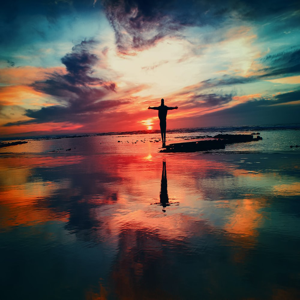

(300, 300)


In [ ]:
# with arguments
size = (300, 300) 
aug_lambda = imaugs.apply_lambda(input_img, aug_function=resize_image, size=size)
display(aug_lambda)
print(aug_lambda.size)

### 2. aug_np_wrapper

Short Desc - Applies a user-defined lambda on a np Image 

Long Desc - This function is a wrapper on all image augmentation functions such that a numpy array could be passed in as input instead of providing the path to the image or a PIL Image. This function applies a user defined function on the given input numpy Image. It gives the flexibility to user to apply any custom function/s on a given input image. 

Input - image(numpy array ), aug_function, **kwargs(function attributes if any)

Output - image(augmented numpy array)

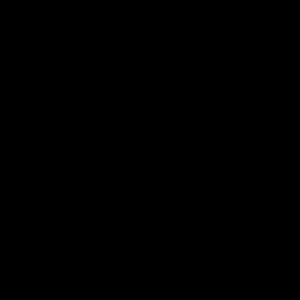

(300, 300)


In [ ]:
np_image = np.zeros((300, 300))
im = Image.fromarray(np_image)
im.show()
print(im.size)

In [ ]:
def resize_image(img=None, size=(100, 100)):
  img_resized = img.resize(size) 
  return img_resized

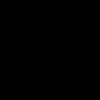

(100, 100)
(100, 100)


In [ ]:
# basic
aug_np = imaugs.aug_np_wrapper(np_image, aug_function=resize_image)
im = Image.fromarray(aug_np)
im.show()
print(im.size)
print(aug_np.shape)

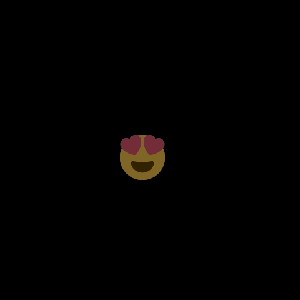

(300, 300)
(300, 300, 4)


In [ ]:
# with arguments
aug_np = imaugs.aug_np_wrapper(np_image, imaugs.overlay_emoji, **{'opacity': 0.5, 'y_pos': 0.45})
im = Image.fromarray(aug_np)
im.show()
print(im.size)
print(aug_np.shape)

### 3. apply_pil_filter

Short Desc - Applies a given PIL filter to the input image  

Long Desc - This function applies a given PIL filter to the input image using `Image.filter()` <br /> Filter types available in PIL - BLUR, CONTOUR, DETAIL, EDGE_ENHANCE, EDGE_ENHANCE_MORE, EMBOSS, FIND_EDGES, SHARPEN, SMOOTH, SMOOTH_MORE

Input - image(PIL format), output_path, filter_type, metadata

Output - image(augmented PIL Image)

NOTE: from PIL import ImageFilter

In [4]:
# #basic 
aug_pil_fl = apply_pil_filter(input_img, ImageFilter.EDGE_ENHANCE_MORE)
display(aug_pil_fl)
print(aug_pil_fl.size)

### 4. blur

Short Desc - Blurs the image

Long Desc - This function blurs a given PIL image. The input parameter radius defines the intensity of blurriness.
It ranges from 0.1 to infinity and cannot be negative

Input - image(PIL format), output_path, radius(float), metadata

Output - image(augmented PIL Image)

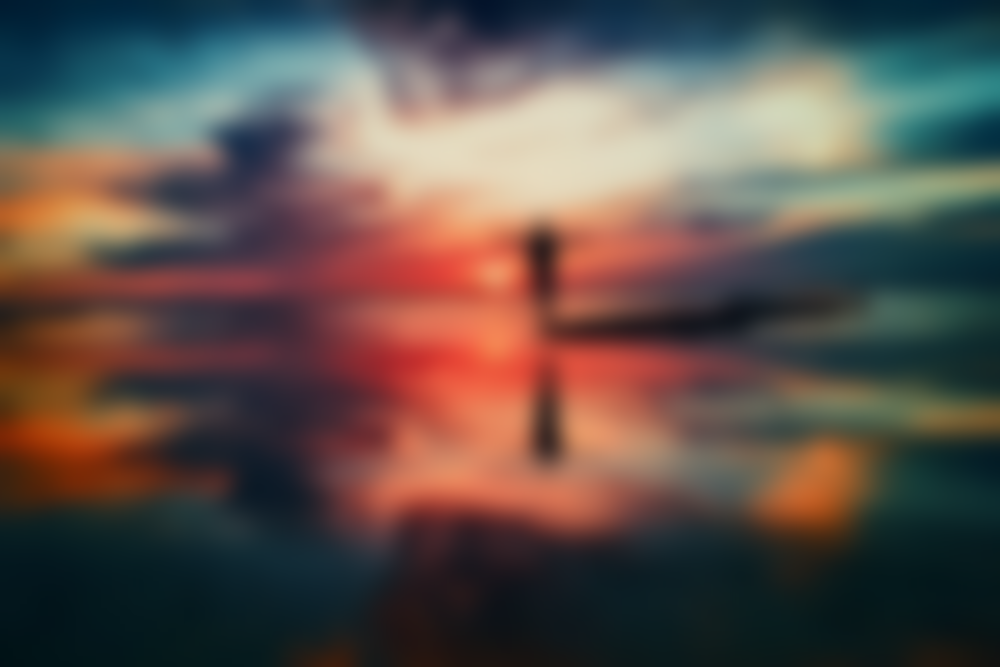

(1000, 667)


In [5]:
#basic 
aug_blr = imaugs.blur(input_img, radius=10.5)
display(aug_blr)

### 5. brightness

Short Desc - Changes the brightness of the image

Long Desc - This function changes the brightness of a given PIL image. The input parameter factor defines the intensity of brightness. The default value is 1.0, values less than this darkens the image and values higher than default brightens the image. Beyond 0 the image blacks out

Input - image(PIL format), output_path, factor(float), metadata

Output - image(augmented PIL Image)

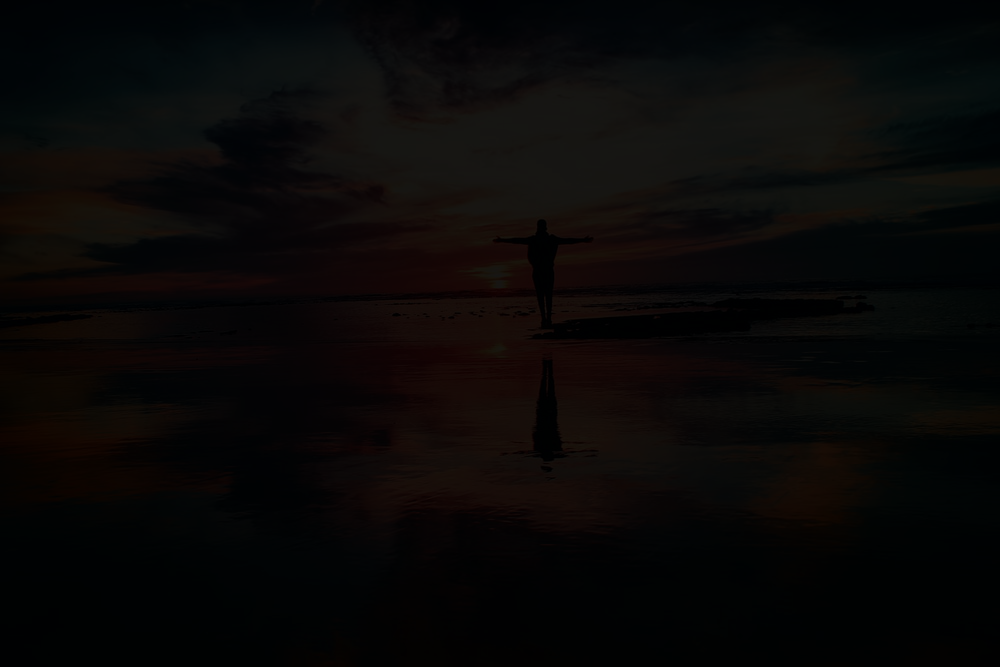

(1000, 667)


In [6]:
#basic 
aug_br = imaugs.brightness(input_img, factor=0.1)
display(aug_br)

### 6. change_aspect_ratio

Short Desc - Changes the aspect ratio of the image

Long Desc - This function changes the aspect ratio of a given PIL image. The input parameter ratio defines the width/height of the new image. The default value is 1.0, values less than default increases height of the image and values higher than default increases width of the image. Ratio can't be negative or 0

Input - image(PIL format), output_path, ratio(float), metadata

Output - image(augmented PIL Image)

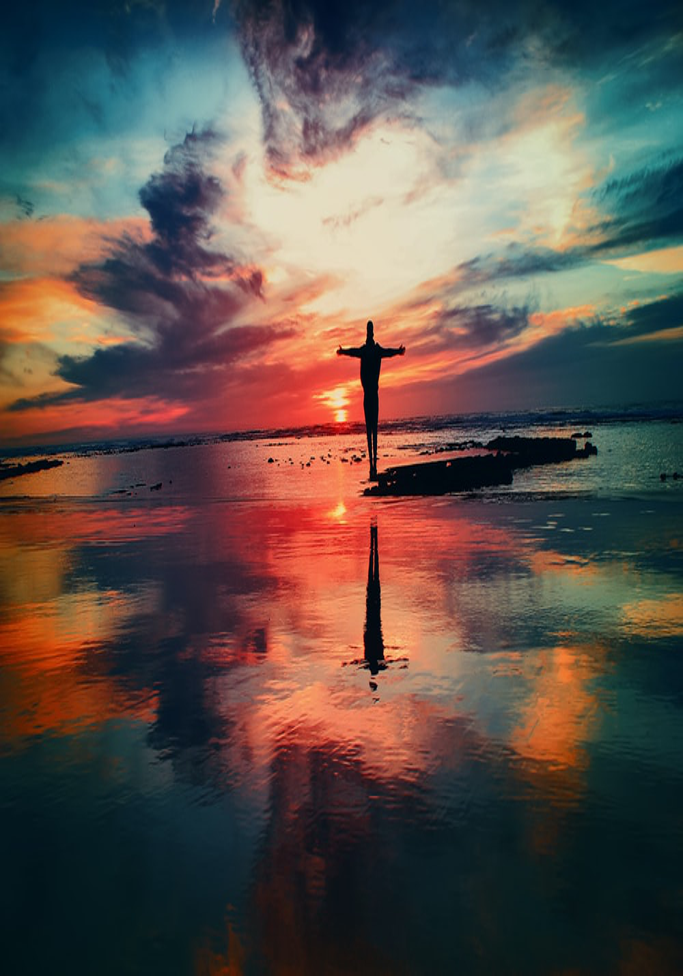

(683, 976)


In [7]:
#basic 
aug_ar = imaugs.change_aspect_ratio(input_img, ratio=0.7)
display(aug_ar)
print(aug_ar.size)

### 7. clip_image_size

Short Desc - Scales the image up or down

Long Desc - This function scales the image up or down if necessary to fit in the given min and max resolution. The minimum resolution, i.e. width * height, that the augmented image should have; if the input image has a lower resolution than this, the image will be scaled up as necessary. The maximum resolution, i.e. width * height, that the augmented image should have; if the input image has a higher resolution than this, the image will be scaled down as necessary 

Input - image(PIL format), output_path, min_resolution(int), max_resolution(int), metadata

Output - image(augmented PIL Image)

In [8]:
#basic 
aug_cl_im_sz = imaugs.clip_image_size(input_img, min_resolution=5, max_resolution=7)
display(aug_cl_im_sz)
print(aug_cl_im_sz.size)

### 8. color_jitter

Short Desc - Color jitters the image

Long Desc - This function enables you to alter the input color by applying a random color variation. It takes three input parameters brightness_factor, contrast_factor, saturation_factor, all defaults to 1.0, to decide the new color of the image

Input - image(PIL format), output_path, brightness_factor(float), contrast_factor(float), saturation_factor(float), metadata

Output - image(augmented PIL Image)

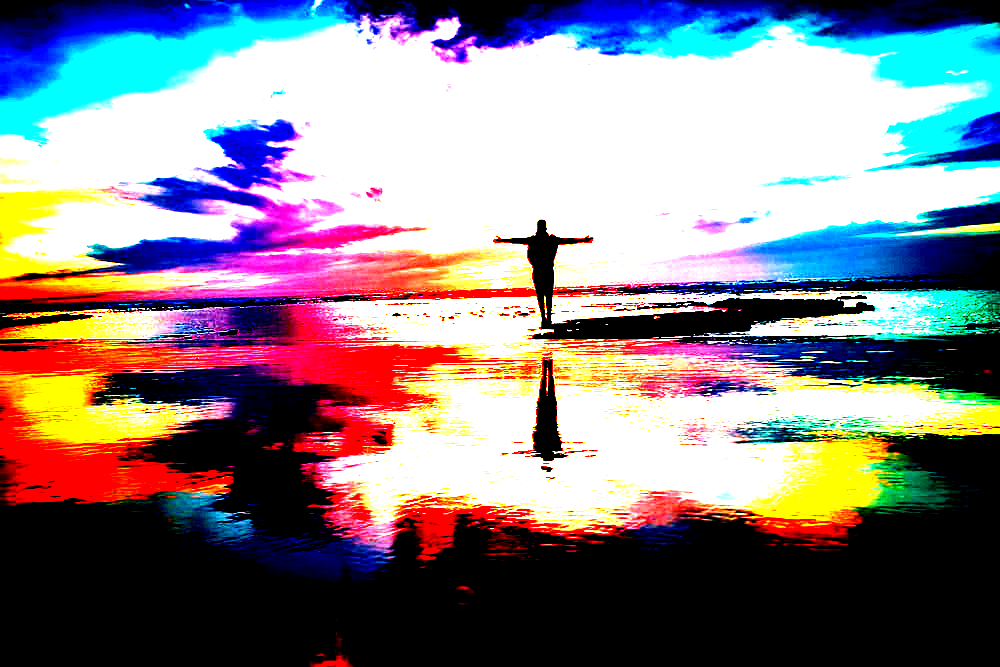

(1000, 667)


In [9]:
#basic 
aug_cl_jt = imaugs.color_jitter(input_img, brightness_factor=2.5, 
                                contrast_factor=5.0, 
                                saturation_factor=1.0)
display(aug_cl_jt)

### 9. contrast

Short Desc - Alters the contrast of the image

Long Desc - This function scales alters the contrast of the image. It takes factor as input which defaults to 1.0. Value of 0 will give greyscale image, below 0 the contrast will appear in grayscale and above 1.0 the contrast will increase

Input - image(PIL format), output_path, factor(float), metadata

Output - image(augmented PIL Image)

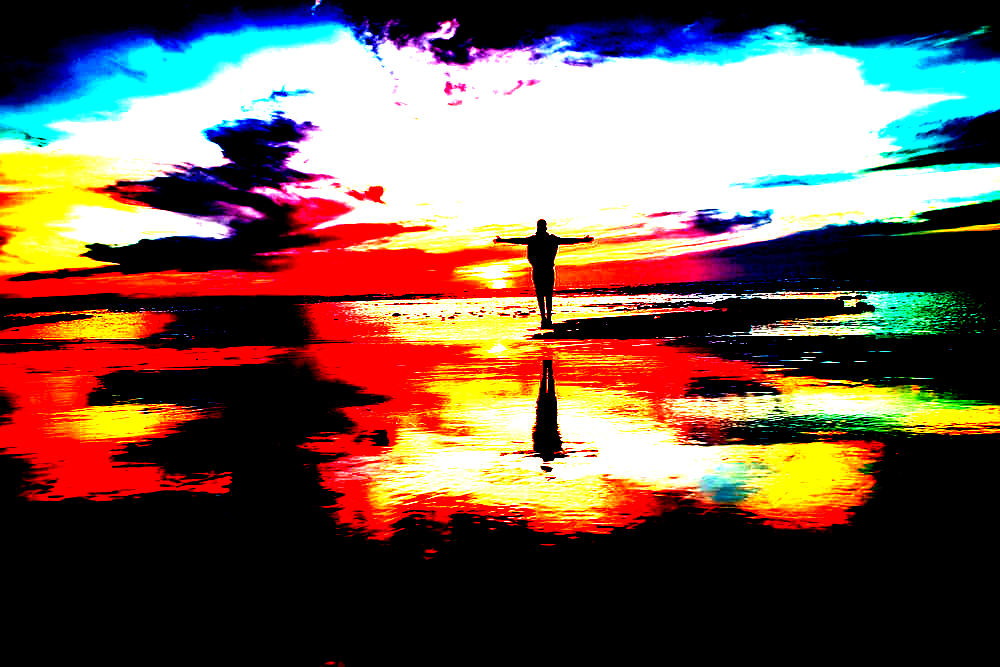

(1000, 667)


In [16]:
#basic 
aug_cont = imaugs.contrast(input_img, factor=10.10)
display(aug_cont)

### 10. convert_color

Short Desc - Converts the image in terms of color modes

Long Desc - This function converts the image in terms of color modes. It takes mode, matrix, dither, palette, colors as input to change the color of an image. mode defines the type and depth of a pixel in the image. If mode is omitted, a mode is chosen so that all information in the image and the palette can be represented without a palette. For list of available modes, check:
https://pillow.readthedocs.io/en/stable/handbook/concepts.html#concept-modes <br/>dithering method, used when converting from mode “RGB” to “P” or from “RGB” or “L” to “1”. Available methods are NONE or FLOYDSTEINBERG (default). Palette to use when converting from mode “RGB” to “P”. Available palettes are WEB or ADAPTIVE. Colors defines number of colors to use for the ADAPTIVE palette. Defaults to 256.

Input - image(PIL format), output_path, mode(str), matrix(tuple), dither(int), palette(int), colors(int), metadata

Output - image(augmented PIL Image)

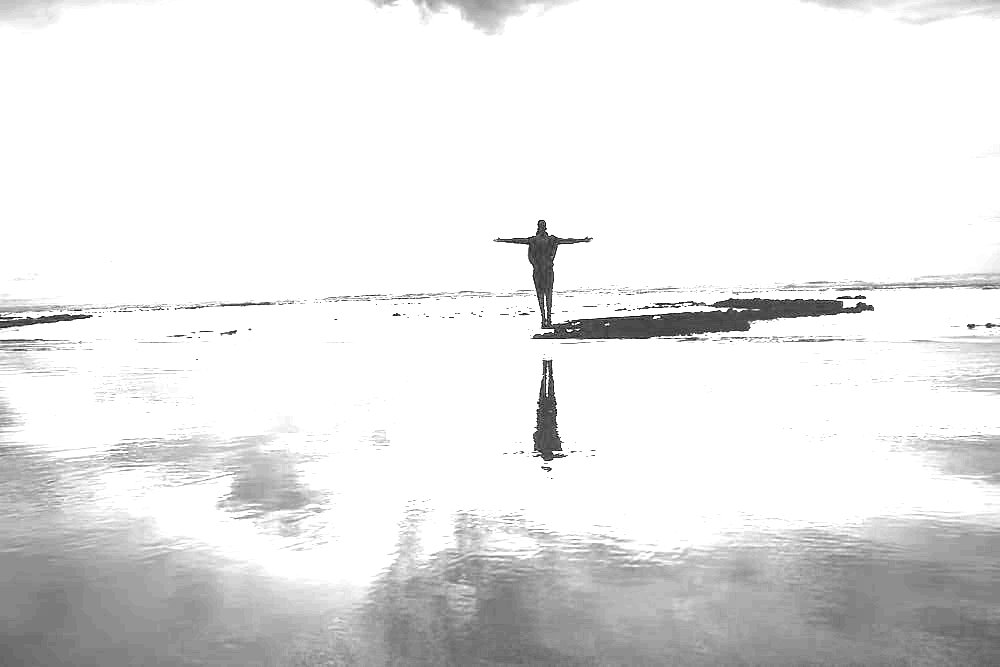

In [18]:
#basic 
aug_cc = imaugs.convert_color(input_img, mode="L", matrix=(1.0, 2.0, 3.0, 4.0), 
                              dither=None, 
                              palette="WEB",
                              colors=128)
display(aug_cc)

### 11. crop

Short Desc - Crops the image

Long Desc - This function crops the image. It accepts 4 parameters x1, x2, y1, y2. x1 is position of the left edge of cropped image relative to the width of the original image; must be a float value between 0 and 1. y1 is position of the top edge of cropped image relative to the height of the original image; must be a float value between 0 and 1. x2 is position of the right edge of cropped image relative to the width of the original image; must be a float value between 0 and 1. y2 is position of the bottom edge of cropped image relative to the height of the original image; must be a float value between 0 and 1


Input - image(PIL format), output_path, x1(float), y1(float), x2(float), y2(float), metadata

Output - image(augmented PIL Image)

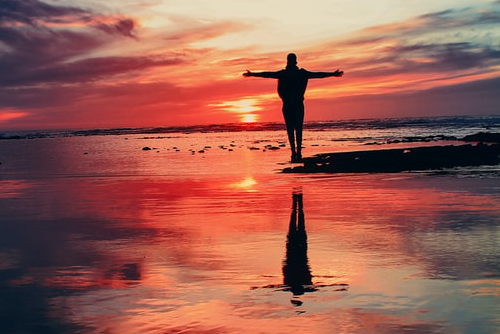

(500, 334)


In [22]:
#basic 
aug_crop = imaugs.crop(input_img, x1 = 0.25, 
                                  y1 = 0.25,
                                  x2 = 0.75,
                                  y2 = 0.75)
display(aug_crop)
print(aug_crop.size)

### 12. encoding_quality

Short Desc - Changes the JPEG encoding quality level

Long Desc - This function changes the JPEG encoding quality level. It accepts quality as parameter with 50 as default value. 0 is lowest quality, 100 is highest

Input - image(PIL format), output_path, quality(int), metadata

Output - image(augmented PIL Image)

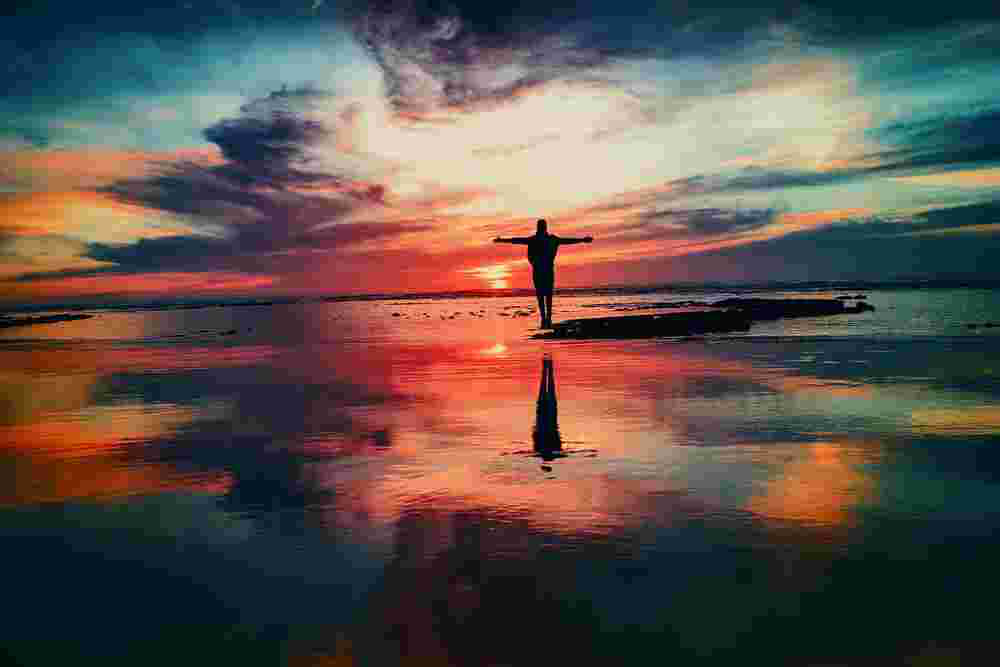

(1000, 667)


In [26]:
#basic 
aug_en_qa = imaugs.encoding_quality(input_img, quality=10)
display(aug_en_qa)

### 13. grayscale

Short Desc - Changes an image to be grayscale

Long Desc - This function changes an image to grayscale. It accepts mode as paramenter which defines the type of greyscale conversion to perform; two options are supported ("luminosity" and "average"). Default value is "luminosity".

Input - image(PIL format), output_path, mode(str), metadata

Output - image(augmented PIL Image)

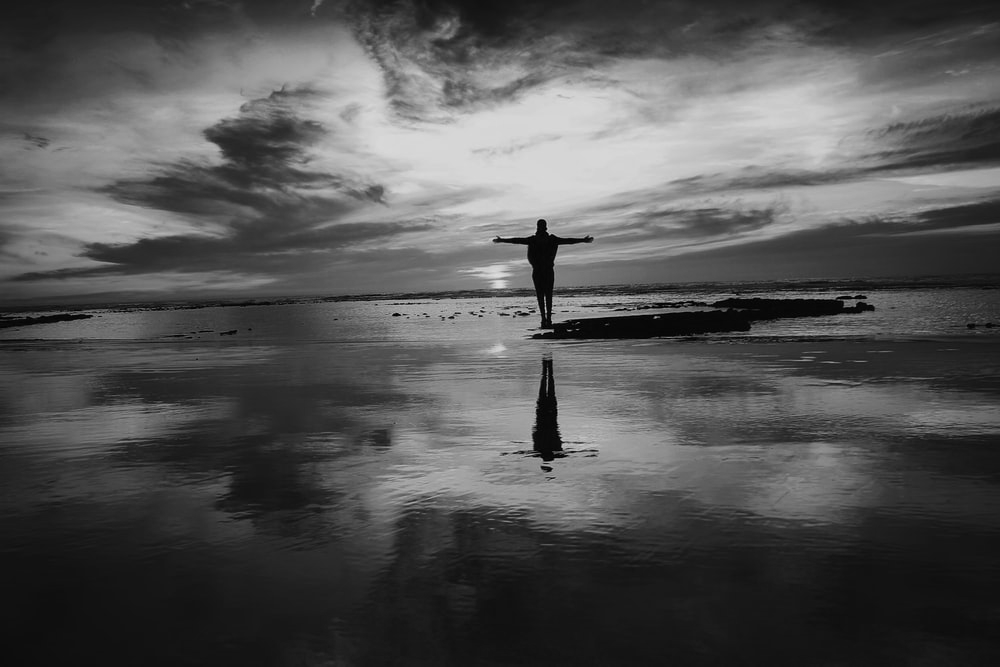

In [29]:
#basic 
aug_gs = imaugs.grayscale(input_img, mode="average")
display(aug_gs)

### 14. hflip

Short Desc - Horizontally flips an image

Long Desc - This function simply flips an image horizontally. 

Input - image(PIL format), output_path, metadata

Output - image(augmented PIL Image)

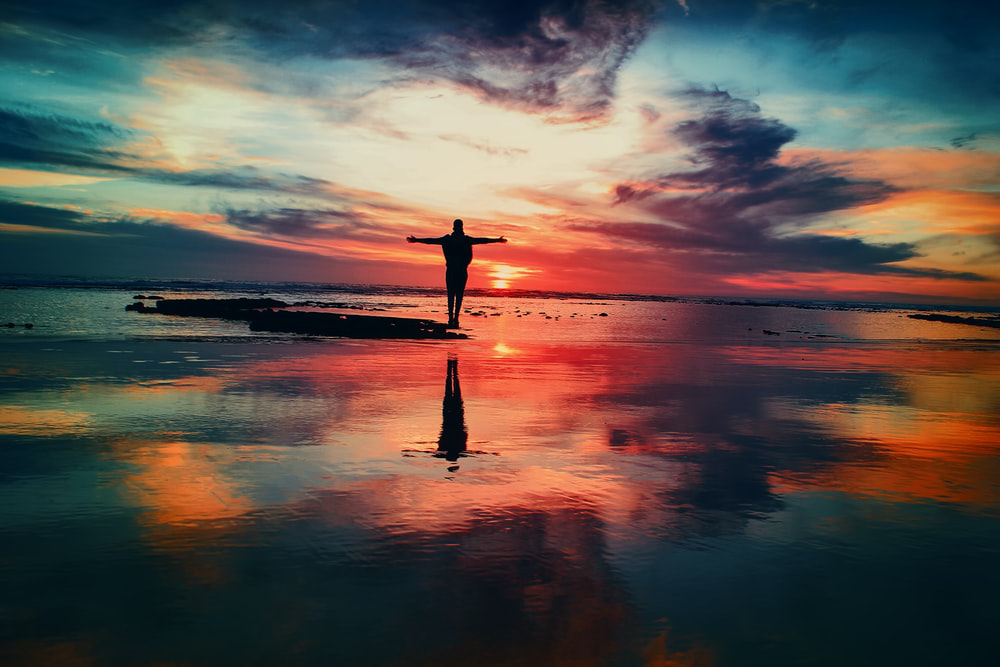

In [31]:
#basic 
aug_hf = imaugs.hflip(input_img)
display(aug_hf)

### 15. masked_composite

Short Desc - Applies given augmentation function to the masked area of the image

Long Desc - This function applies given augmentation function to the masked area of the image. It accepts 2 parameters mask and transform_function. mask is the path to an image or a variable of type PIL.Image.Image for masking. This image can have mode “1”, “L”, or “RGBA”, and must have the same size as the other two images. If the mask is not provided the function returns the augmented image. transform_function is the augmentation function to be applied. If transform_function is not provided, the function returns the input image

Input - image(PIL format), output_path, mask(str), transform_function, metadata

Output - image(augmented PIL Image)

In [70]:
def resize_image(img=None, size=(667,1000)):
  new_img = img.resize(size) 
  return new_img

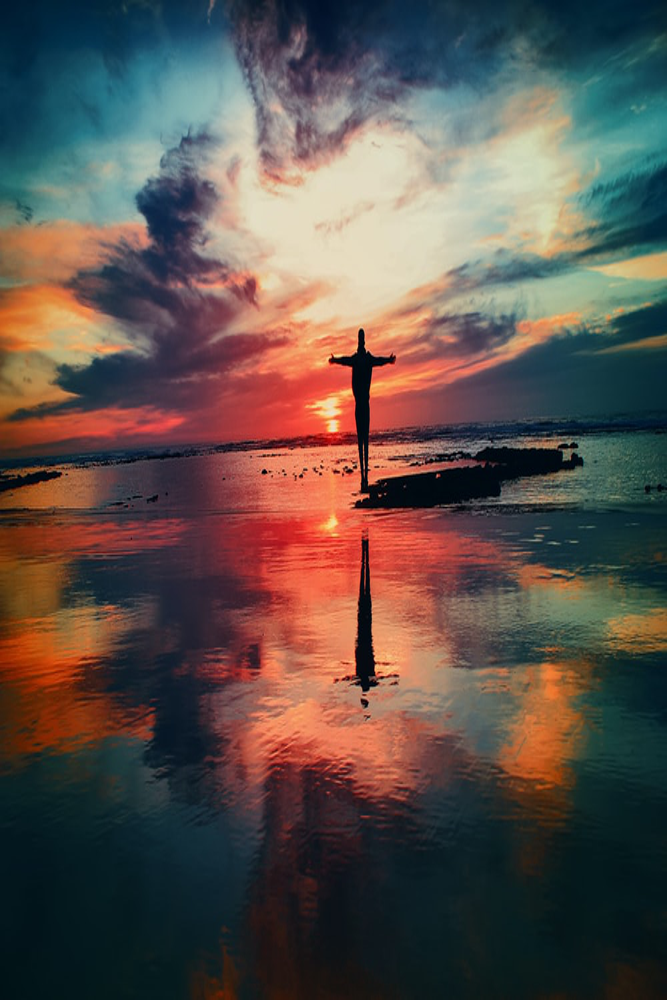

(667, 1000)


In [71]:
#basic 
aug_mc = imaugs.masked_composite(input_img, transform_function=resize_image)
display(aug_mc)
print(aug_mc.size)

### 16. meme_format

Short Desc - Creates a new image that looks like a meme, given text and an image

Long Desc - This function creates a new image that looks like a meme, given text and an image. It takes text, font_file, opacity, text_color, caption_height, meme_bg_color as input. text is the text to be overlaid/used in the meme. font_file is the iopath uri to a .ttf font file. opacity is the lower the opacity, the more transparent the text. text_color is color of the text in RGB values. caption_height is the height of the meme caption. meme_bg_color is background color of the meme caption in RGB values

Input - image(PIL format), output_path, text(str), font_file(str), opacity(float), text_color(Tuple), caption_height(int), meme_bg_color(Tuple), metadata

Output - image(augmented PIL Image)

Note: if using a very long string, please add in newline characters such that the text remains in a readable font size.

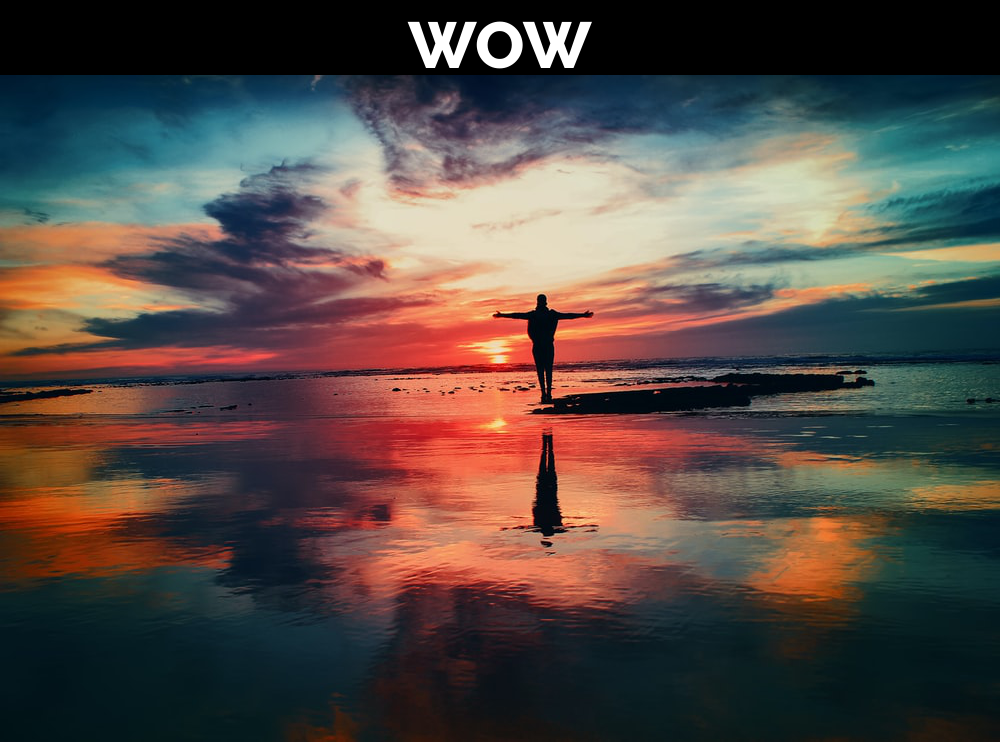

In [73]:
#basic 
aug_mf = imaugs.meme_format(input_img, text="WOW",
                              font_file=utils.MEME_DEFAULT_FONT,
                              opacity=0.5,
                              caption_height=75, 
                              meme_bg_color=(0, 0, 0),
                              text_color=(255, 255, 255),)
display(aug_mf)

### 17. opacity

Short Desc - Alter the opacity of an image

Long Desc - This function alters the opacity of an image. It accepts level as parameter which defines the opacity that should be set to, where 0 means completely transparent and 1 means no transparency at all. Default is 1.0.

Input - image(PIL format), output_path, level(float), metadata

Output - image(augmented PIL Image)

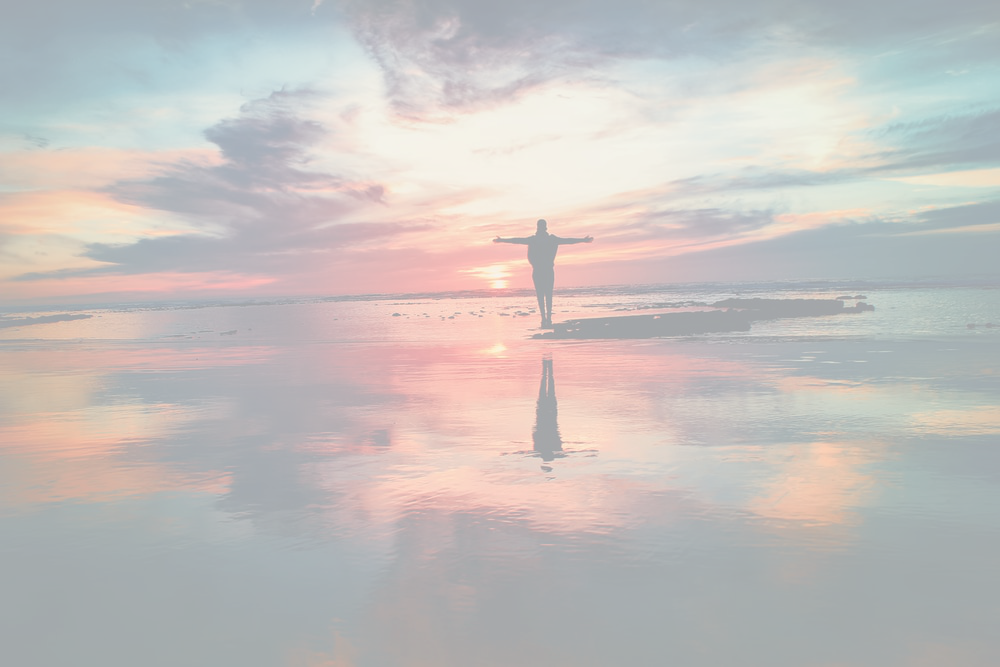

In [77]:
#basic 
aug_op = imaugs.opacity(input_img, level=0.6)
display(aug_op)

### 18. overlay_emoji

Short Desc - Overlay an emoji onto the original image

Long Desc - This function overlays an emoji onto the original image. It accepts emoji_path, opacity, emoji_size, x_pos, y_pos. emoji_path is the iopath uri to the emoji image. opacity is the lower the opacity, the more transparent the overlaid emoji. emoji_size is the size of the emoji is emoji_size * height of the original image. x_pos is position of emoji relative to the image width. y_pos is position of emoji relative to the image height.
All values should be between 0,1

Input - image(PIL format), output_path, emoji_path(str), opacity(float), emoji_size(float), x_pos(float), y_pos(float), metadata

Output - image(augmented PIL Image)

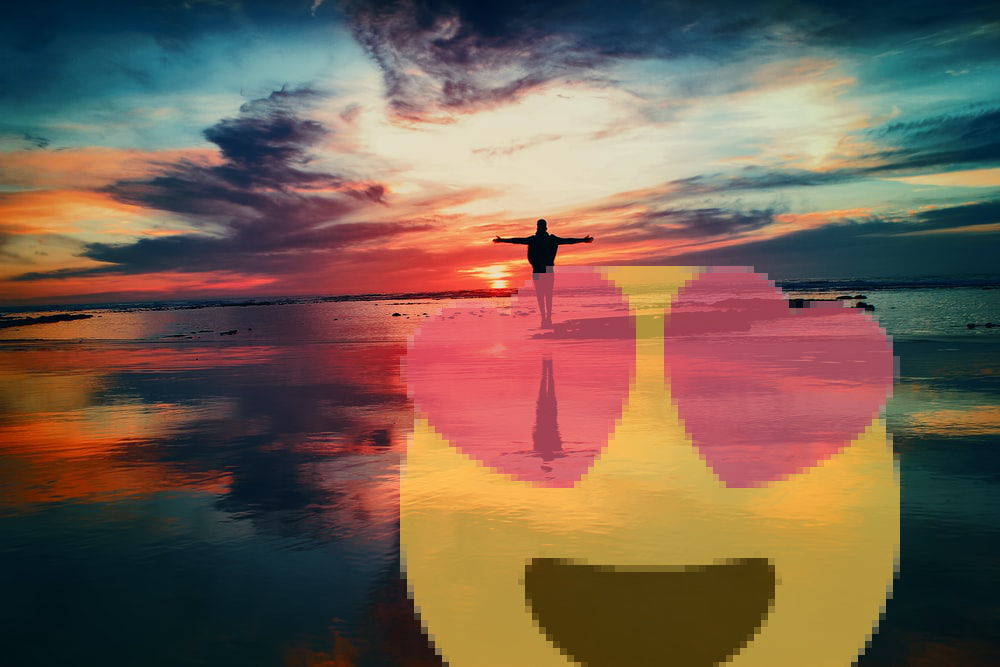

In [84]:
#basic 
aug_oe = imaugs.overlay_emoji(input_img, 
                                emoji_path = utils.EMOJI_PATH,
                                opacity = 0.7,
                                emoji_size = 0.75,
                                x_pos = 0.4,
                                y_pos = 0.4)
display(aug_oe)

### 19. overlay_image

Short Desc - Overlays an image onto another image

Long Desc - This function overlays an image onto another image at position (width * x_pos, height * y_pos). It accepts overlay, opacity, overlay_size, x_pos, y_pos. overlay is the path to an image or a variable of type PIL.Image.Image that will be overlaid. opacity is the lower the opacity, the more transparent the overlaid image. overlay_size is size of the overlaid image is overlay_size * height of the original image. x_pos is the position of overlaid image relative to the image width .y_pos is position of overlaid image relative to the image height. All values should be between 0,1

Input - image(PIL format), output_path, overlay(str), opacity(float), overlay_size(float), x_pos(float), y_pos(float), metadata

Output - image(augmented PIL Image)

In [85]:
np_img = np.ones((300,300))
img2 = Image.fromarray(np_img)

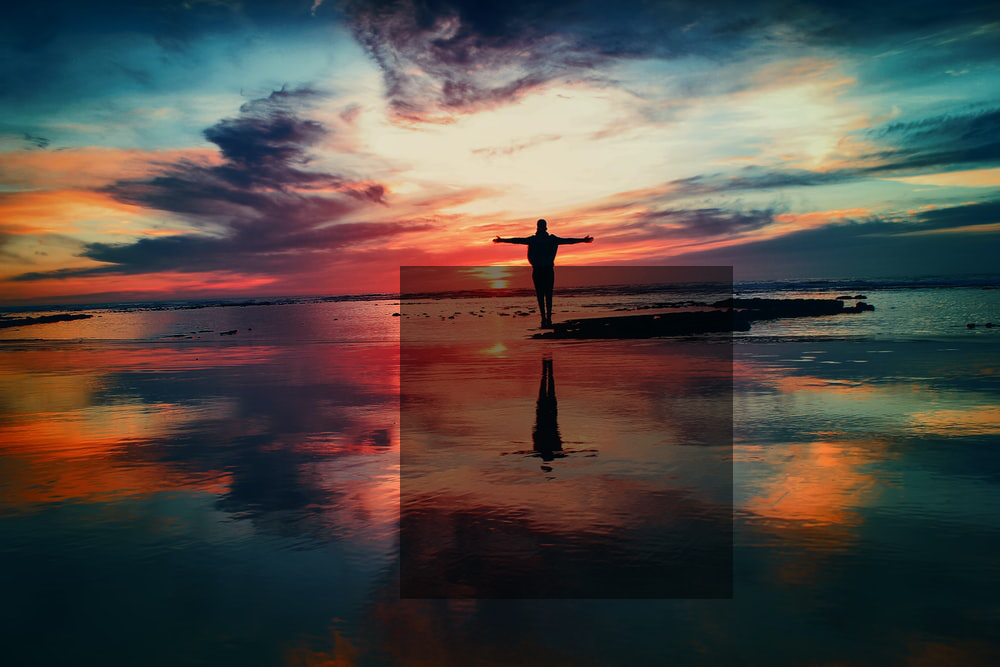

In [89]:
#basic 
aug_oi = imaugs.overlay_image(input_img, 
                              overlay=img2,
                              opacity=0.5,
                              overlay_size = 0.5,
                              x_pos = 0.4,
                              y_pos = 0.4)
display(aug_oi)

### 20. overlay_onto_background_image

Short Desc - Overlays the image onto a given background image

Long Desc - This function overlays an image onto another image at position (width * x_pos, height * y_pos). It accepts background_image, opacity, overlay_size, x_pos, y_pos.  background_image is the path to an image or a variable of type PIL.Image.Image onto which the source image will be overlaid. opacity is the lower the opacity, the more transparent the overlaid image. overlay_size is size of the overlaid image is overlay_size * height of the background image. x_pos is position of overlaid image relative to the background image width with respect to the x-axis. y_pos is position of overlaid image relative to the background image height with respect to the y-axis. scale_bg if True, the background image will be scaled up or down so that. overlay_size is respected. if False, the source image will be scaled instead. All values should be between 0,1

Input - image(PIL format), output_path, background_image:(PIL format), opacity(float), overlay_size(float), x_pos(float), y_pos(float), scale_bg(bool), metadata

Output - image(augmented PIL Image)

In [90]:
np_img = np.zeros((300,300))
img2 = Image.fromarray(np_img)

In [93]:
#basic 
aug_bcg_img = imaugs.overlay_onto_background_image(input_img, 
                                                   background_image = img2,
                                                    opacity = 1.0,
                                                    overlay_size = 1.0,
                                                    x_pos = 0.4,
                                                    y_pos = 0.4,
                                                    scale_bg = False)
display(aug_bcg_img)

### 21. overlay_onto_screenshot

Short Desc - Overlay the image onto a screenshot template

Long Desc - This function scales overlay the image onto a screenshot template so it looks like it was screenshotted on Instagram. It accepts template_filepath, template_bboxes_filepath, max_image_size_pixels, crop_src_to_fit, resize_src_to_match_template. template_filepath is iopath uri to the screenshot template. template_bboxes_filepath is iopath uri to the file containing the bounding box for each template. max_image_size_pixels if provided, the template image and/or src image will be scaled down to avoid an output image with an area greater than this size (in pixels). 
crop_src_to_fit if True, the src image will be cropped if necessary to fit into the template image if the aspect ratios are different. If False, the src image will instead be resized if needed. resize_src_to_match_template if True, the src image will be resized if it is too big or small in both dimensions to better match the template image. If False, the template image will be resized to match the src image instead. It can be useful to set this to True if the src image is very large so that the augmented image isn't huge, but instead is the same size as the template image


Input - image(PIL format), output_path,template_filepath(str), template_bboxes_filepath(str), max_image_size_pixels(int), crop_src_to_fit(bool), resize_src_to_match_template(bool), metadata

Output - image(augmented PIL Image)

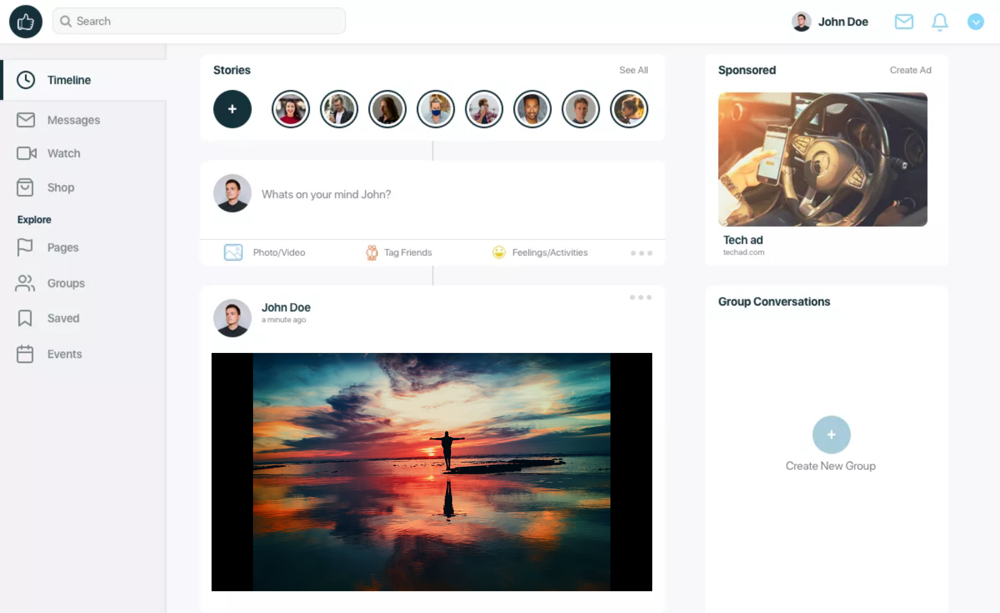

(2798, 1716)


In [104]:
#basic 
aug_ss = imaugs.overlay_onto_screenshot(input_img, 
                                          template_filepath = utils.TEMPLATE_PATH,
                                          template_bboxes_filepath = utils.BBOXES_PATH,
                                          max_image_size_pixels = None,
                                          crop_src_to_fit  = False,
                                          resize_src_to_match_template = True)
display(aug_ss)
print(aug_ss.size)

### 22. overlay_stripes

Short Desc - Overlay stripe pattern onto the image

Long Desc - This function overlay stripe pattern onto the image (by default, white horizontal stripes are overlaid). It accepts line_width, line_color, line_angle, line_density, line_type, line_opacity. line_width is the width of individual stripes as a float value ranging from 0 to 1. Defaults to 0.5. line_color is color of the overlaid stripes in RGB values. line_angle is the angle of the stripes in degrees, ranging from -360° to 360°. Defaults to 0° or horizontal stripes. line_density controls the distance between stripes represented as a float value ranging from 0 to 1, with 1 indicating more densely spaced stripes. Defaults to 0.5. line_type is the type of stripes. Current options include: dotted, dashed, and solid. Defaults to solid. line_opacity is the opacity of the stripes, ranging from 0 to 1 with 1 being opaque. Defaults to 1.0

Input - image(PIL format), output_path, line_width(float), line_color(Tuple), line_angle(float), line_density(float), line_type(str), line_opacity(float), metadata

Output - image(augmented PIL Image)

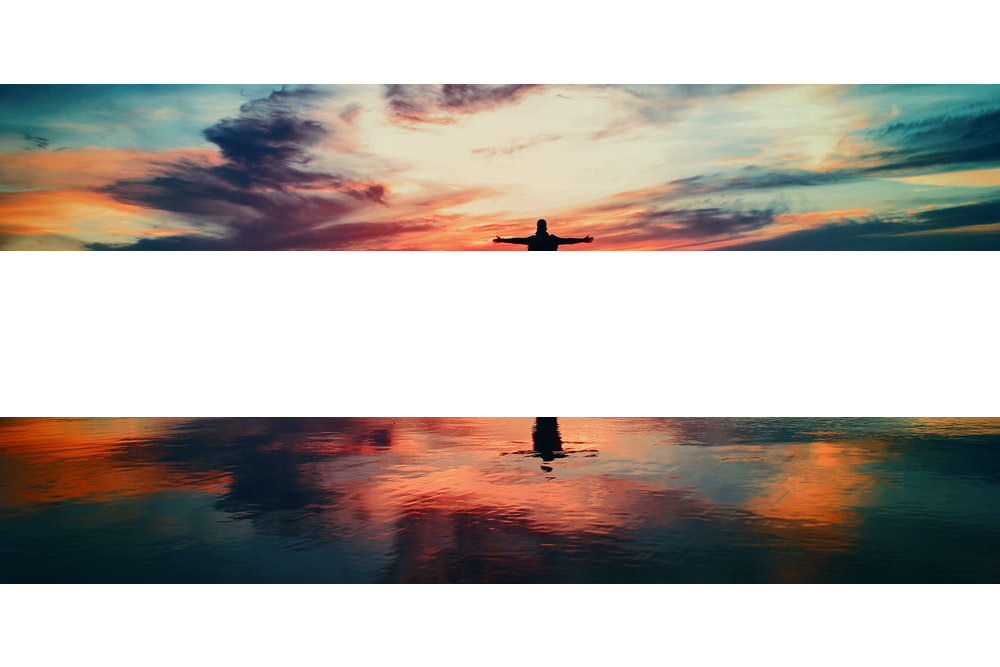

(1000, 667)


In [97]:
#basic 
aug_os = imaugs.overlay_stripes(input_img, 
                                  line_width = 0.5,
                                  line_color = utils.WHITE_RGB_COLOR,
                                  line_angle = 0,
                                  line_density = 0.5,
                                  line_type = "solid",
                                  line_opacity = 1.0)
display(aug_os)
print(aug_os.size)

### 23. overlay_text

Short Desc - Overlay text onto the image

Long Desc - This function overlays text onto the image (by default, text is randomly overlaid). It accepts text, font_file, font_size, opacity, color, x_pos, y_pos. text is indices (into the file) of the characters to be overlaid. Each line of text is represented as a list of int indices; if a list of lists is supplied, multiple lines of text will be overlaid. font_file is iopath uri to the .ttf font file. font_size is size of the overlaid characters, calculated as font_size * min(height, width) of the original image. opacity is the lower the opacity, the more transparent the overlaid text. color is color of the overlaid text in RGB values. x_pos is position of the overlaid text relative to the image width. y_pos is position of the overlaid text relative to the image height 

Input - image(PIL format), output_path, text(list), font_file(str), font_size(float), opacity(float), color(tuple), x_pos(float), y_pos(float), metadata

Output - image(augmented PIL Image)

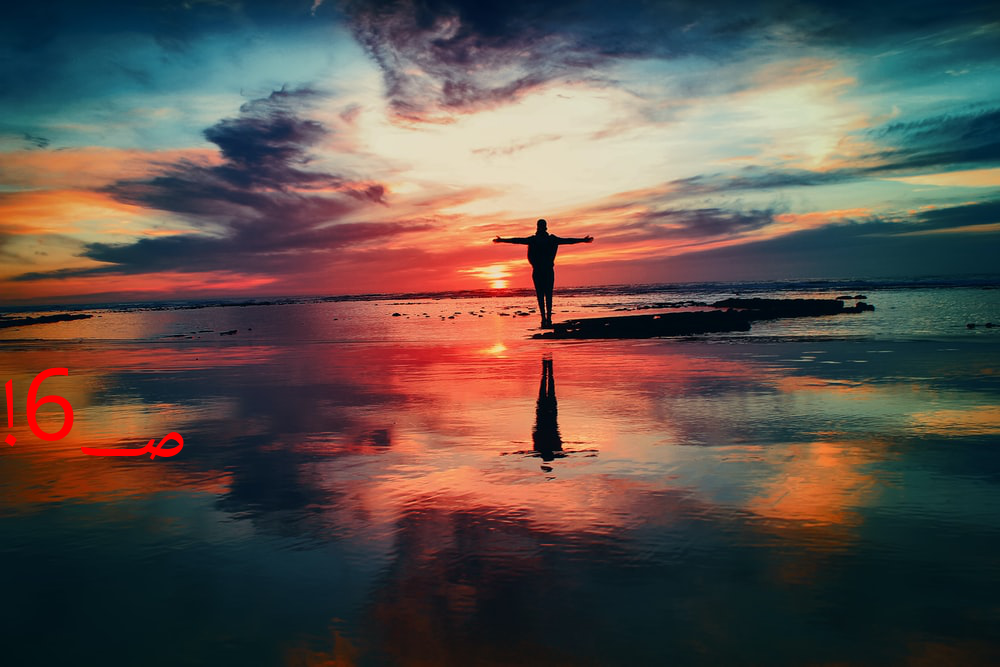

(1000, 667)


In [105]:
#basic 
aug_ot = imaugs.overlay_text(input_img, 
                               text = [1,10,20],
                               font_file = utils.FONT_PATH,
                               font_size = 0.15,
                               opacity = 1.0,
                               color = utils.RED_RGB_COLOR,
                               x_pos = 0.0,
                               y_pos = 0.5,)
display(aug_ot)
print(aug_ot.size)

### 24. pad

Short Desc - Pads the image

Long Desc - This function just pads the image. It accepts w_factor, h_factor, color. w_factor pads the width * w_factor pixels to both left and right of the image. h_factor pads the height * h_factor pixels to the top and the bottom of the image. color is the color of the padded border in RGB values

Input - image(PIL format), output_path, w_factor(float), h_factor(float), color(Tuple[int, int, int]), metadata

Output - image(augmented PIL Image)

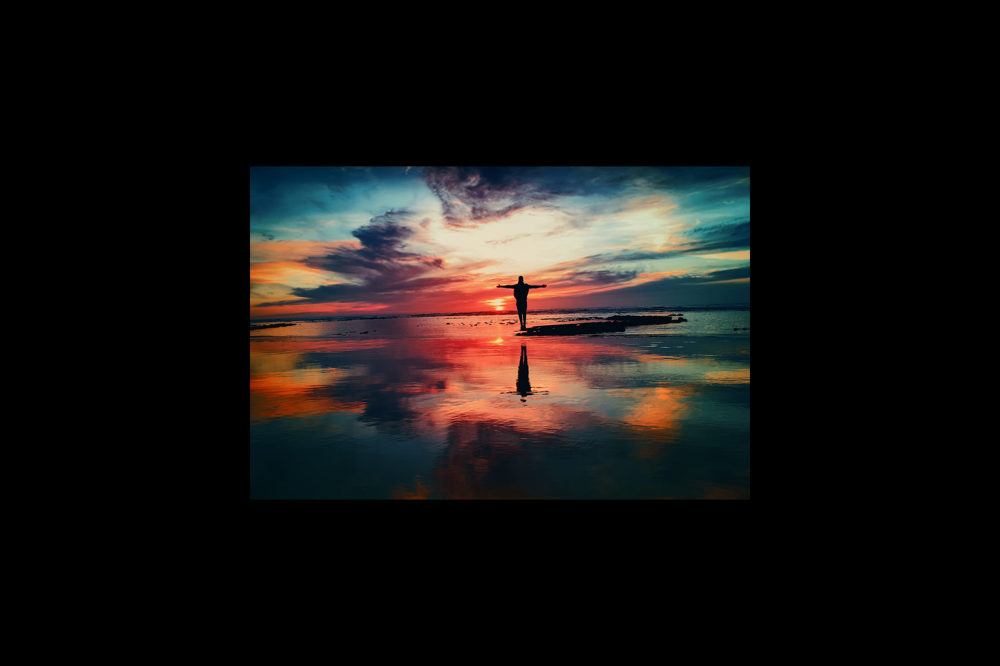

(2000, 1333)


In [106]:
#basic 
aug_pad = imaugs.pad(input_img, 
                      w_factor = 0.5,
                      h_factor = 0.5,
                      color = utils.DEFAULT_COLOR)
display(aug_pad)
print(aug_pad.size)

### 25. pad_square

Short Desc - Pads the shorter edge of the image

Long Desc - This function pads the shorter edge of the image such that it is now square-shaped. It accepts color as input. color is basically the color of the padded border in RGB values

Input - image(PIL format), output_path, color(Tuple[int, int, int]), metadata

Output - image(augmented PIL Image)

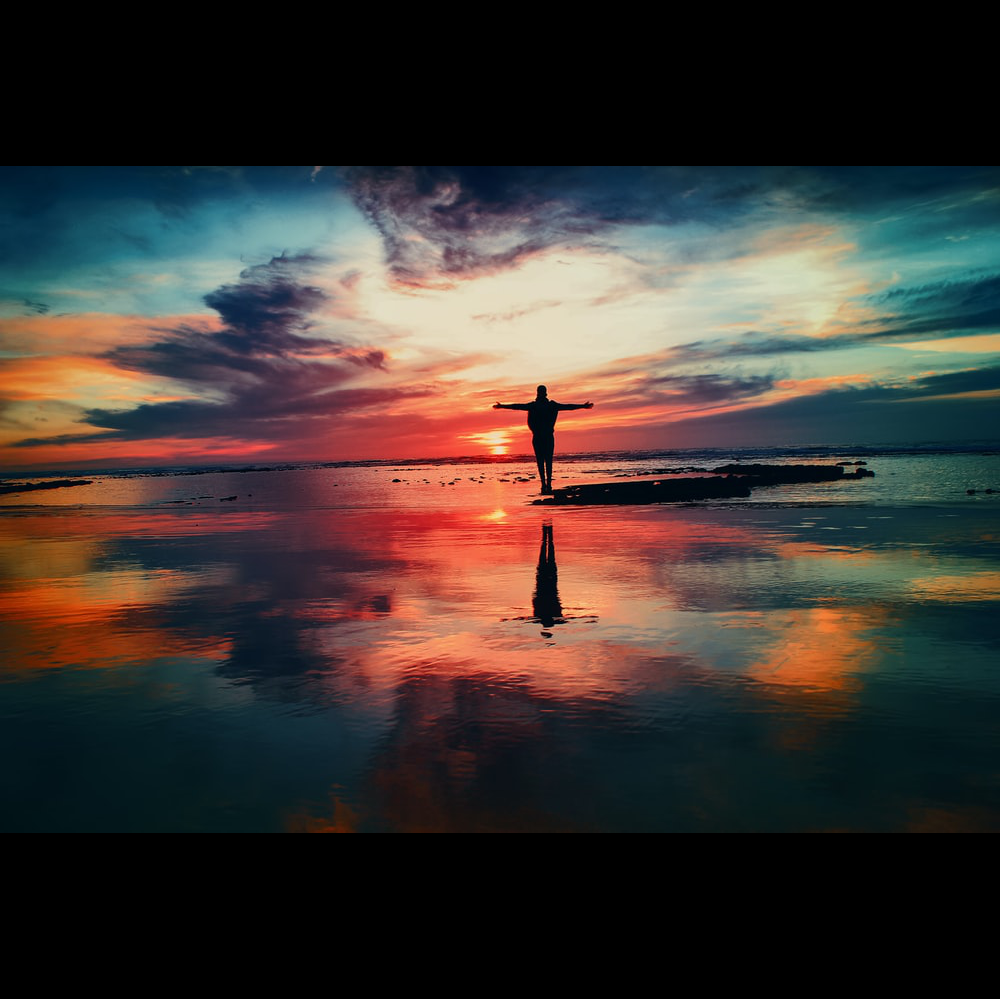

(1000, 999)


In [107]:
#basic 
aug_pad_sq = imaugs.pad_square(input_img, color = utils.DEFAULT_COLOR,)
display(aug_pad_sq)
print(aug_pad_sq.size)

### 26. perspective_transform

Short Desc - Apply a perspective transform to the image

Long Desc - This function applies a perspective transform to the image so it looks like it was taken as a photo from another device (e.g. taking a picture from your phone of a picture on a computer). It accepts sigma, dx, dy, seed, crop_out_black_border. sigma is the standard deviation of the distribution of destination coordinates. the larger the sigma value, the more intense the transform. dx is the change in x for the perspective transform; instead of providing `sigma` you can provide a scalar value to be precise. dy is the change in y for the perspective transform; instead of providing `sigma` you can provide a scalar value to be precise. seed if provided, this will set the random seed to ensure consistency between runs. crop_out_black_border if True, will crop out the black border resulting from the perspective transform by cropping to the largest center rectangle with no black

Input - image(PIL format), output_path, sigma(float), dx(float), dy(float), seed(int), crop_out_black_border(bool), metadata

Output - image(augmented PIL Image)

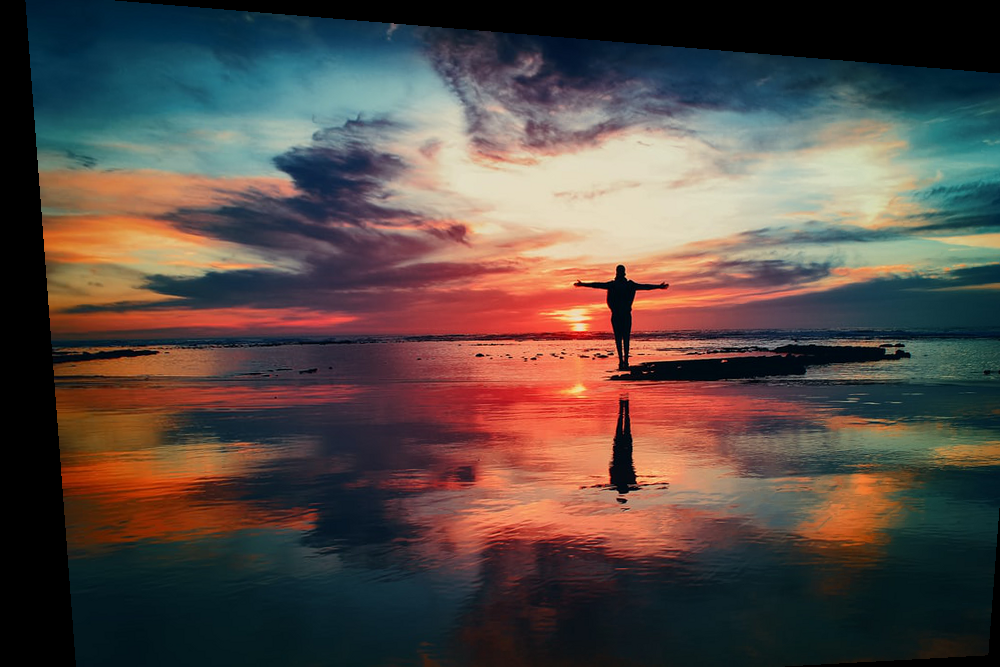

(1000, 667)


In [108]:
#basic 
aug_pt = imaugs.perspective_transform(input_img,
                                        sigma = 50.0,
                                        dx = 0.0,
                                        dy = 0.0,
                                        seed = 42,
                                        crop_out_black_border = False)
display(aug_pt)
print(aug_pt.size)

### 27. pixelization

Short Desc - Pixelizes an image

Long Desc - This function just pixelizes an image. It accepts ratio. smaller values result in a more pixelated image, 1.0 indicates no change, and any value above one doesn't have a noticeable effect

Input - image(PIL format), output_path, ratio(float), metadata

Output - image(augmented PIL Image)

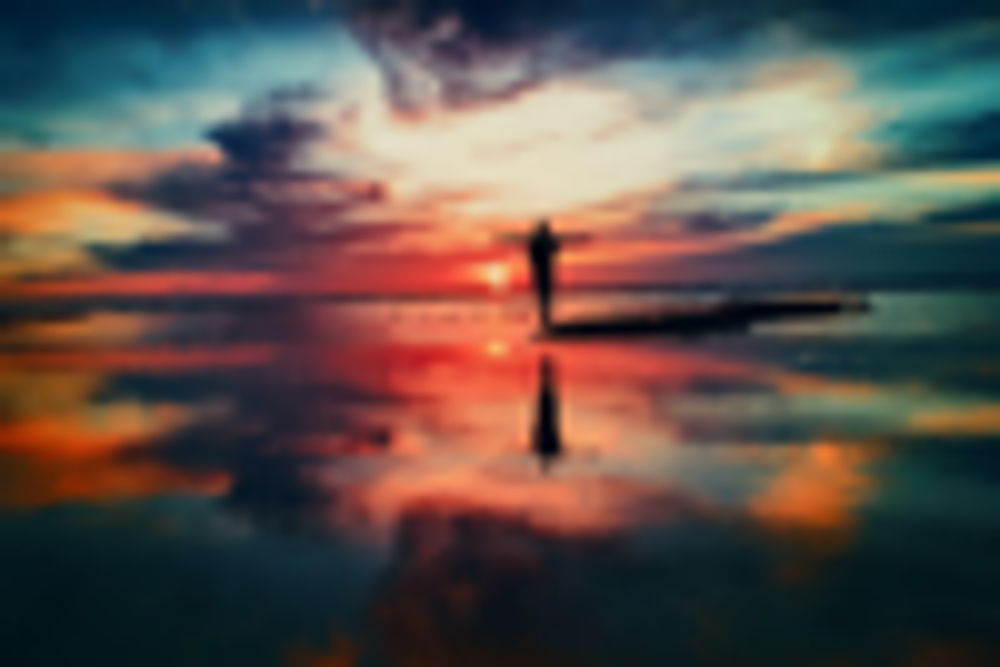

In [114]:
#basic 
aug_cont = imaugs.pixelization(input_img, ratio = 0.1)
display(aug_cont)

### 28. random_noise

Short Desc - Adds random noise to the image

Long Desc - This function adds random noise to the image. It accepts mean, var, seed. mean is the mean of gaussian noise added. Value of mean should be between 0,1. var is the variance of the gaussian noise added. seed if provided, this will set the random seed before generating noise

Input - image(PIL format), output_path, mean(float), var(float), seed(int), metadata

Output - image(augmented PIL Image)

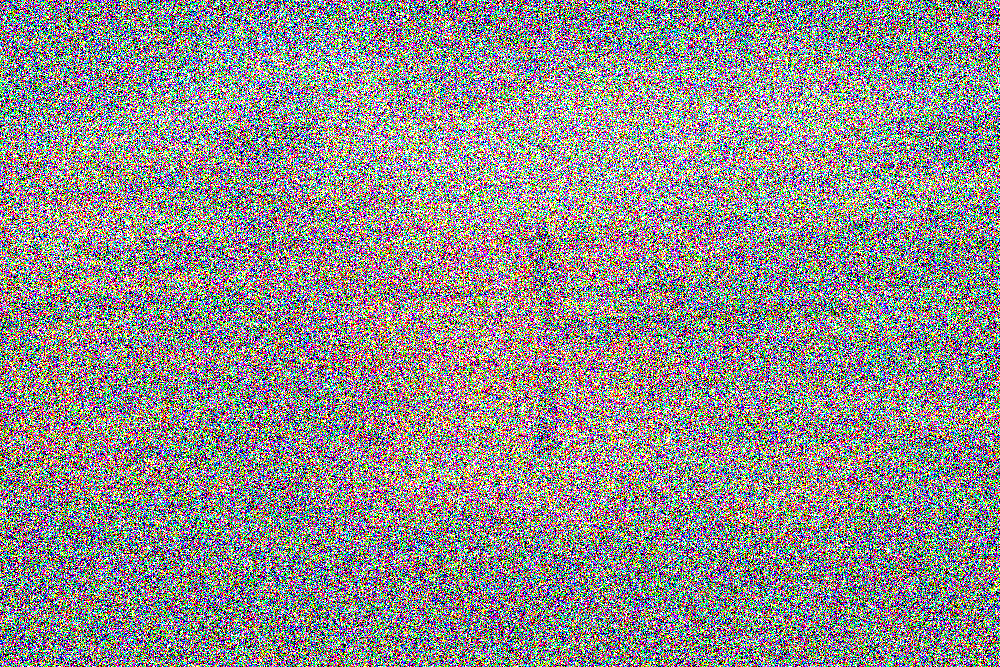

In [120]:
#basic 
aug_rn = imaugs.random_noise(input_img, 
                               mean = 0.5, 
                               var = 5.01,
                               seed = 42)
display(aug_rn)

### 29. resize

Short Desc - Resizes an image

Long Desc - This function resizes an image. It accepts width, height. width isthe desired width the image should be resized to have. If None, the original image width will be used. height is the desired height the image should be resized to have. If None, the original image height will be used

Input - image(PIL format), output_path, width(int), height(int), metadata

Output - image(augmented PIL Image)

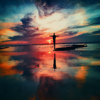

(100, 100)


In [122]:
#basic 
aug_re = imaugs.resize(input_img, 
                         width = 100,
                         height = 100)
display(aug_re)
print(aug_re.size)

### 30. rotate

Short Desc - Rotates the image

Long Desc - This function rotates the image. It accepts degress which is the amount of degrees that the original image will be rotated counter clockwise

Input - image(PIL format), output_path, degrees(float), metadata

Output - image(augmented PIL Image)

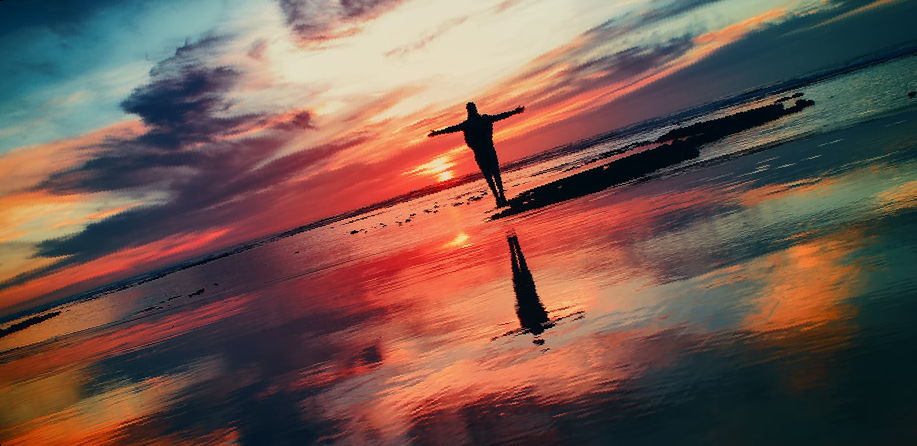

(917, 446)


In [124]:
#basic 
aug_ro = imaugs.rotate(input_img, degrees = 15.0,)
display(aug_ro)
print(aug_ro.size)

### 31. saturation

Short Desc - Alters the saturation of the image

Long Desc - This function alters the saturation of the image. It accepts factor which is a saturation factor of below 1.0 lowers the saturation, a factor of 1.0 gives the original image, and a factor greater than 1.0 adds saturation

Input - image(PIL format), output_path, factor(float), metadata

Output - image(augmented PIL Image)

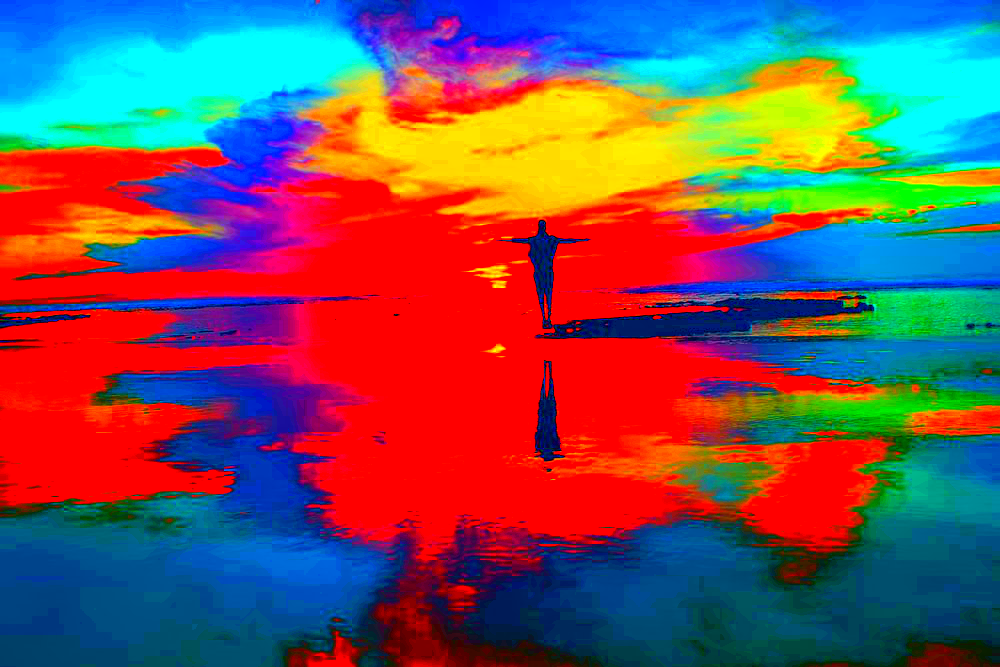

In [125]:
#basic 
aug_sat = imaugs.saturation(input_img, factor=10.10)
display(aug_sat)

### 32. scale

Short Desc - Alters the resolution of an image

Long Desc - This function alters the resolution of an image. It accepts factor, interpolation as input. factor is the ratio by which the image should be downscaled or upscaled. interpolation is basically interpolation method. This can be one of PIL.Image.NEAREST, PIL.Image.BOX, PIL.Image.BILINEAR, PIL.Image.HAMMING, PIL.Image.BICUBIC or PIL.Image.LANCZOS

Input - image(PIL format), output_path, factor(float), interpolation(int), metadata

Output - image(augmented PIL Image)

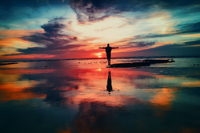

(200, 133)


In [129]:
#basic 
aug_sc = imaugs.scale(input_img, 
                        factor = 0.2,
                        interpolation = Image.BICUBIC)
display(aug_sc)
print(aug_sc.size)

### 33. sharpen

Short Desc - Changes the sharpness of the image

Long Desc - This function changes the sharpness of the image. It accepts factor. A factor of below 1.0 blurs the image, a factor of 1.0 gives he original image, and a factor greater than 1.0 sharpens the image

Input - image(PIL format), output_path, factor(float), metadata

Output - image(augmented PIL Image)

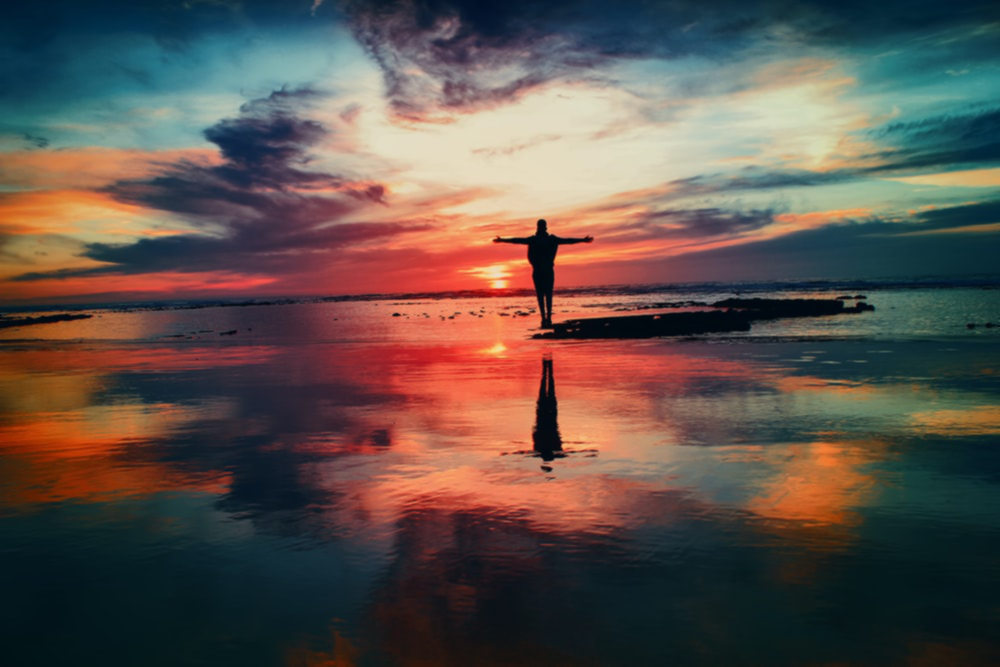

In [132]:
#basic 
aug_shrp = imaugs.sharpen(input_img, factor=-10.10)
display(aug_shrp)

### 34. shuffle_pixels

Short Desc - Shuffles the pixels of an image

Long Desc - This function shuffles the pixels of an image with respect to the shuffling factor. The factor denotes percentage of pixels to be shuffled and randomly selected. It is a control parameter between 0.0 and 1.0. While a factor of 0.0 returns the original image, a factor of 1.0 performs full shuffling. seed if provided, this will set the random seed before generating noise
    

Input - image(PIL format), output_path, factor(float), seed(int), metadata

Output - image(augmented PIL Image)

Note: The actual number of pixels will be less than the percentage given due to the probability of pixels staying in place in the course of shuffling

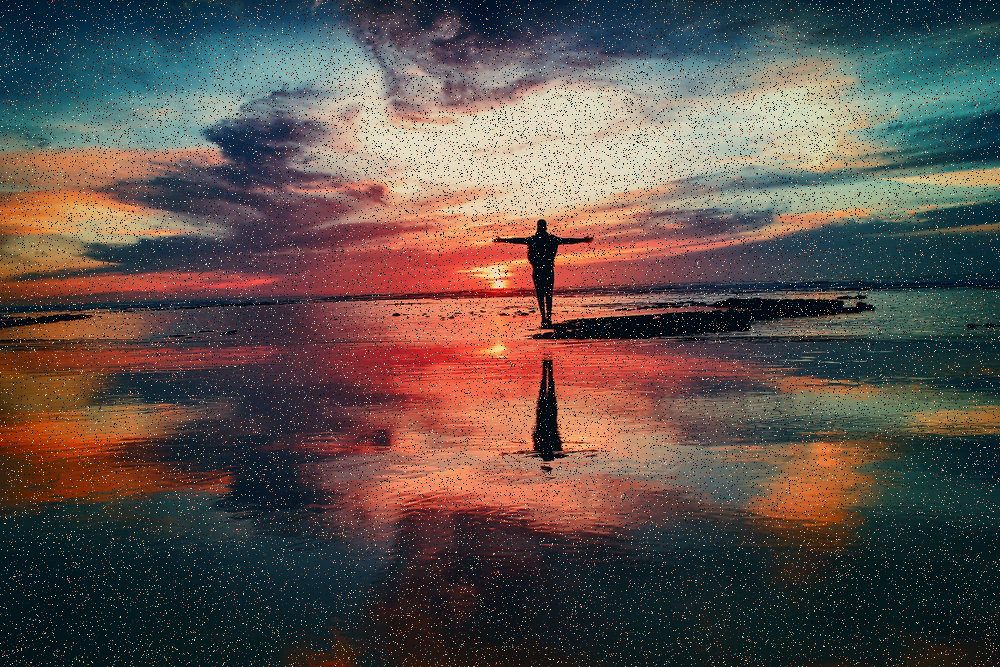

In [134]:
#basic 
aug_sh_px = imaugs.shuffle_pixels(input_img, factor=0.10, seed = 42)
display(aug_sh_px)

### 35. vflip

Short Desc - Vertically flips an image

Long Desc - This function just vertically flips an image

Input - image(PIL format), output_path, metadata

Output - image(augmented PIL Image)

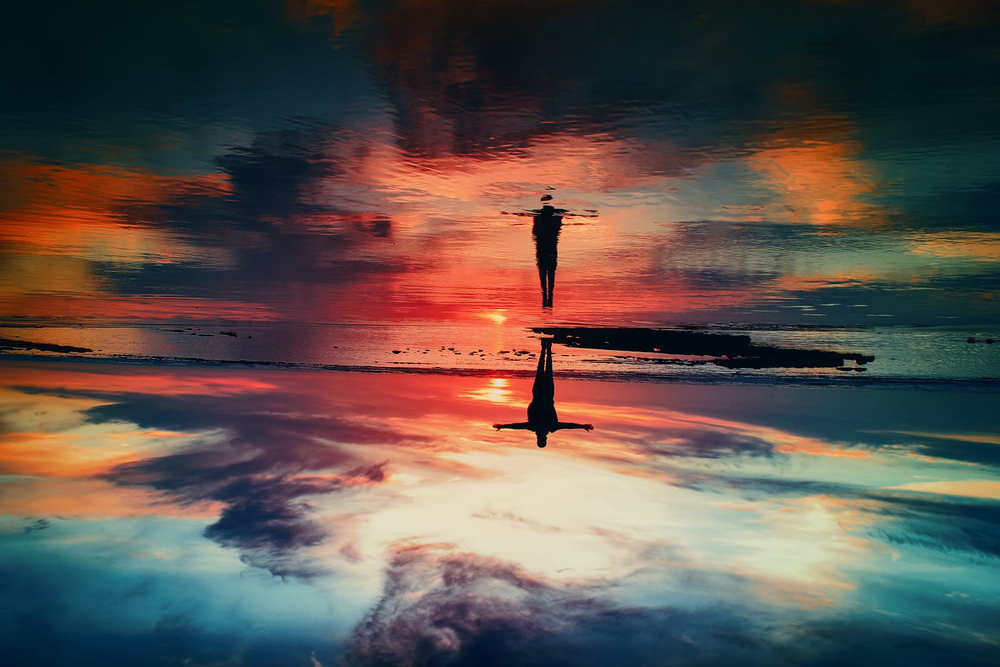

(1000, 667)


In [135]:
#basic 
aug_vf = imaugs.vflip(input_img)
display(aug_vf)
print(aug_vf.size)